# Predicting voters turnout for US election in 2016 using AutoML and spatial feature engineering - Part II

## Table of Contents <a class="anchor" id="0"></a>
* [Introduction](#1) 
* [Imports](#2)
* [Connecting to ArcGIS](#3)
* [Estimating Spatial Autocorrelation](#7)  
    * [Calculating Local Moran's I](#7a)
    * [Visualizing the spatial autocorrelation](#7b)
    * [Selecting highly significant spatial clustering county](#7c)
    * [Estimating distances and angle of counties from highly clustered counties](#7d)
    * [Final dataset with spatial cluster variables](#7e) 
* [Model Building](#5a)
     * [Train-Test split](#5b)
     * [Fitting a random forest model ](#5c)
     * [Data Preprocessing](#5d)
     * [Fitting Using AutoML](#5e)
     * [Model output](#5f) 
* [Voters turnout prediction & Validation](#8a)
     * [Estimate model metrics for validation](#8c)
* [Conclusion](#10)
* [Data resources](#25)    

## Introduction <a class="anchor" id="1"></a>

The objective of this notebook is to demonstrate the application of AutoML on tabular data and show the improvements that can be achieved using this method, rather than conventional workflows. In part 1 of this notebook series, a considerable increase was obtained when implementing AutoML, and in this notebook, the result will be further enhanced using spatial feature engineering. These new features will be estimated by considering, and subsequently extracting, the inherent spatial patterns present in the data.  

The percentage of voter turnout by county for the general election for US in 2016 will be predicted using the demographic characteristics of US counties and their socioeconomic parameters.

## Imports <a class="anchor" id="2"></a>

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import pandas as pd
from pathlib import Path
from IPython.display import Image, HTML
from fastai.imports import *
from datetime import datetime as dt

import arcgis
from arcgis.gis import GIS
from arcgis.learn import prepare_tabulardata, AutoML, MLModel
import arcpy

## Connecting to ArcGIS <a class="anchor" id="3"></a>

In [2]:
gis = GIS("home")

## Accessing & Visualizing datasets  <a class="anchor" id="4"></a> 

The 2016 election data is downloaded from the portal as a zipped shapefile, which is then unzipped and processed in the following.

<Item title:"VotersTurnoutCountyEelction2016" type:Shapefile owner:api_data_owner>
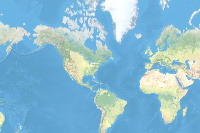

In [3]:
voter_zip = gis.content.get('650e7d6aa8fb4601a75d632a2c114425') 
voter_zip

In [4]:
import os, zipfile

In [5]:
filepath_new = voter_zip.download(file_name=voter_zip.name)
with zipfile.ZipFile(filepath_new, 'r') as zip_ref:
    zip_ref.extractall(Path(filepath_new).parent)
output_path = Path(os.path.join(os.path.splitext(filepath_new)[0]))
output_path = os.path.join(output_path,"VotersTurnoutCountyEelction2016.shp")  

The attribute table contains voter turnout data per county for the entire US, which is extracted here as a pandas dataframe. The `voter_turn` field in the dataframe contains voter turnout percentages for each county for the 2016 election. This will be used as the dependent variable and will be predicted using the various demographic and socioeconomic variables of each county.

In [6]:
# getting the attribute table from the shapefile which will be used for building the model
sdf_main = pd.DataFrame.spatial.from_featureclass(output_path)
sdf_main.head()

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,NNeighbors,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE
0,0,1,1,01001,Autauga,Alabama,0.613738,38.6,25553,4.96,...,44,0.21158,0.154568,0,0,249674.500799,2208597808.5,133735.292502,0,"{""rings"": [[[-9619465, 3856529.0001000017], [-..."
1,1,1,2,01003,Baldwin,Alabama,0.627364,42.9,31429,4.64,...,22,0.358894,0.057952,0,0,1642763.26146,5671095677.35,241925.196426,3,"{""rings"": [[[-9746859, 3539643.0001000017], [-..."
2,2,1,3,01005,Barbour,Alabama,0.513816,40.2,16876,3.49,...,62,-0.868722,-0.498354,1,1,320297.06515,3257816458.5,0.0,0,"{""rings"": [[[-9468394, 3771591.0001000017], [-..."
3,3,1,4,01007,Bibb,Alabama,0.501364,39.3,19360,3.64,...,43,-1.003341,0.28644,0,0,227910.108916,2311954706.0,170214.485759,7,"{""rings"": [[[-9692114, 3928124.0001000017], [-..."
4,4,1,5,01009,Blount,Alabama,0.603064,40.9,21785,3.86,...,51,0.096177,-0.336198,0,1,291875.255483,2456919058.5,21128.568784,7,"{""rings"": [[[-9623907, 4063676.0001000017], [-..."


In [7]:
sdf_main.shape

(3112, 97)

Here, the data is visualized by mapping the voter turnout field into five classes. It can be observed that there are belts running along the eastern and southern parts of the country that represent comparatively lower voter turnout of less than 55%. 

The AutoMl process significantly improves the fit, compared to the standalone random forest model, and the validation R-squared jumps to a new high. Now, the previous visualization of the data reveals the presence of a spatial pattern in the data. Next, this spatial pattern will be estimated and included as spatial features to further improve the model.

## Estimating Spatial Autocorrelation  <a class="anchor" id="7"></a>

This characteristic is also known as spatial autocorrelation and is measured by the index known as Moran's I, which is estimated using the  `ClustersOutliers` tool available in Arcpy.

In [8]:
# First the Arcpy env is specified which will be used saving the result of the Arcpy tool
arcpy.env.workspace = output_path.replace(output_path.split('\\')[-1], "arcpy_test_env")

if os.path.exists(arcpy.env.workspace):
    shutil.rmtree(arcpy.env.workspace)

os.makedirs(arcpy.env.workspace)

### Calculating Local Moran's I<a class="anchor" id="7a"></a> 

The [`ClustersOutliers`](https://pro.arcgis.com/en/pro-app/latest/tool-reference/spatial-statistics/cluster-and-outlier-analysis-anselin-local-moran-s.htm) tool will calculate the local Moran's I index for each county and identify statistically significant hot spots, cold spots, and spatial outliers. As input, the tool takes the shapefile containing the data, the field name for which the clustering is to be estimated, and the output name of the shapefile, and outputs a Moran's I value, a z-score, a pseudo p-value, and a code representing the cluster type for each statistically significant feature. The z-scores and pseudo p-values represent the statistical significance of the computed index values.  

In [9]:
arcpy.env.workspace = arcpy.env.workspace 
output_path = output_path 

In [10]:
result = arcpy.stats.ClustersOutliers(output_path,
                                      "voter_turn", "voters_turnout_ClusterOutlier.shp",
                                     'INVERSE_DISTANCE',
                                     'EUCLIDEAN_DISTANCE','ROW', "#", "#","NO_FDR", 499)

In [11]:
# accessing the attribute table from the output shapefile
sdf_main_LMi = pd.DataFrame.spatial.from_featureclass(result[0])
sdf_main_LMi.head()

,FID,SOURCE_ID,voter_turn,LMiIndex,LMiZScore,LMiPValue,COType,NNeighbors,ZTransform,SpatialLag,SHAPE
0,0,0,0.613738,0.032693,0.95507,0.176,,44,0.21158,0.154568,"{""rings"": [[[-9619465, 3856529.0001000017], [-..."
1,1,1,0.627364,0.020792,0.318927,0.376,,22,0.358894,0.057952,"{""rings"": [[[-9746859, 3539643.0001000017], [-..."
2,2,2,0.513816,0.432791,3.572737,0.002,LL,62,-0.868722,-0.498354,"{""rings"": [[[-9468394, 3771591.0001000017], [-..."
3,3,3,0.501364,-0.287305,-1.828555,0.042,LH,43,-1.003341,0.28644,"{""rings"": [[[-9692114, 3928124.0001000017], [-..."
4,4,4,0.603064,-0.032324,-2.317385,0.012,HL,51,0.096177,-0.336198,"{""rings"": [[[-9623907, 4063676.0001000017], [-..."


Here, the Moran's I value is stored in the `LMiIndex`, field, with its z-score and pseudo p-value in the fields `LMiZScore` and `LMiPValue`respectively, and the code in `COType`.

### Visualizing the spatial autocorrelation<a class="anchor" id="7b"></a>

The `COType` field in the Output Feature Class will be HH for a statistically significant cluster of high values and LL for a statistically significant cluster of low values. The `COType` field in the Output Feature Class will also indicate if the feature has a high value and is surrounded by features with low values (HL) or if the feature has a low value and is surrounded by features with high values (LH). This is visualized in the map below: 

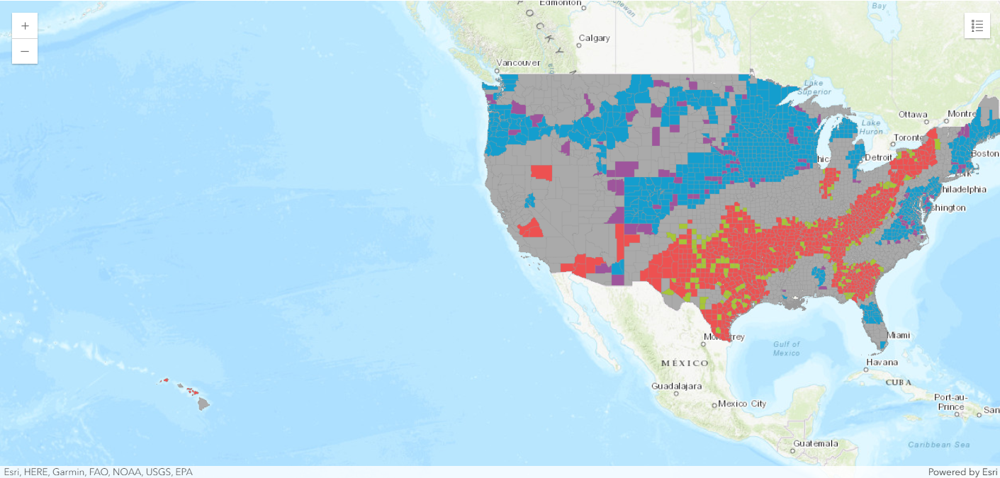

In [12]:
# visualizing spatial autocorrelation in voters turnout
m2 = gis.map('United States')
m2.legend.enabled = True
m2

In [13]:
m2.content.add(sdf_main_LMi)

In [14]:
m2.zoom_to_layer(sdf_main_LMi)

Apply symbology to the feature layer

In [15]:
sm_manager = m2.content.renderer(0).smart_mapping()
sm_manager.unique_values_renderer(field="COType")

The black pixels in the map above show that there is spatial clustering of low voter turnout along the eastern coast, while the white pixels in the northeastern, central, and northwestern portions of the country indicate areas of spatial clustering of high voter turnout.

To include this data as spatial features, the counties with the most significant (lowest) p-values will be identified, and the distance and the angle or direction of each county will be measured from those lowest-p value counties. These two variables, the distance and the angle, are included as the new spatial features in the model.

In [16]:
# checking the field names having the p values
sdf_main_LMi.columns

Index(['FID', 'SOURCE_ID', 'voter_turn', 'LMiIndex', 'LMiZScore', 'LMiPValue',
       'COType', 'NNeighbors', 'ZTransform', 'SpatialLag', 'SHAPE'],
      dtype='object')

### Selecting highly significant spatial clustering county <a class="anchor" id="7c"></a>

The most significant (lowest) p-value here is 0.002. All counties with this p value will be selected, and a field will be created that will be used to generate a shapefile containing these highly significant counties. Another field will also be created for counties with p-values less than or equal to 0.05, representing the remaining significantly clustering counties, that will be used as the third spatial feature in the final model.

In [17]:
# creating new fields with highly significant clustering counties
sdf_main_LMi['LMi_hi_sig<.002'] =  np.where(sdf_main_LMi['LMiPValue']<=.002, 1,0)
sdf_main_LMi['LMi_sig_<0.05'] =  np.where(sdf_main_LMi['LMiPValue']<=.05, 1,0)
sdf_main_LMi.head()

,FID,SOURCE_ID,voter_turn,LMiIndex,LMiZScore,LMiPValue,COType,NNeighbors,ZTransform,SpatialLag,SHAPE,LMi_hi_sig<.002,LMi_sig_<0.05
0,0,0,0.613738,0.032693,0.95507,0.176,,44,0.21158,0.154568,"{""rings"": [[[-9619465, 3856529.0001000017], [-...",0,0
1,1,1,0.627364,0.020792,0.318927,0.376,,22,0.358894,0.057952,"{""rings"": [[[-9746859, 3539643.0001000017], [-...",0,0
2,2,2,0.513816,0.432791,3.572737,0.002,LL,62,-0.868722,-0.498354,"{""rings"": [[[-9468394, 3771591.0001000017], [-...",1,1
3,3,3,0.501364,-0.287305,-1.828555,0.042,LH,43,-1.003341,0.28644,"{""rings"": [[[-9692114, 3928124.0001000017], [-...",0,1
4,4,4,0.603064,-0.032324,-2.317385,0.012,HL,51,0.096177,-0.336198,"{""rings"": [[[-9623907, 4063676.0001000017], [-...",0,1


In [18]:
# create new dataframe for LMi_hi_sig<.002 
LMi_hi_sig_county_main = sdf_main_LMi[sdf_main_LMi['LMi_hi_sig<.002']==1].copy()

In [19]:
LMi_hi_sig_county_main.columns

Index(['FID', 'SOURCE_ID', 'voter_turn', 'LMiIndex', 'LMiZScore', 'LMiPValue',
       'COType', 'NNeighbors', 'ZTransform', 'SpatialLag', 'SHAPE',
       'LMi_hi_sig<.002', 'LMi_sig_<0.05'],
      dtype='object')

In [20]:
# creating a new shapefile for the most significant clustering counties from spatial dataframe 
near_dist_from_main_county = sdf_main_LMi.spatial.to_featureclass('voters_turnout_train_LMi'+str(dt.now().microsecond))
near_dist_to_hi_sig_county = LMi_hi_sig_county_main.spatial.to_featureclass('LMi_hi_sig_county_train'+str(dt.now().microsecond))

### Estimating distances and angle of counties from highly clustered counties<a class="anchor" id="7d"></a>

The [`Near`(Analysis)](https://pro.arcgis.com/en/pro-app/latest/tool-reference/analysis/near.htm) tool from Arcpy is used to calculate the distance and the angle of all the counties from the highly significant clustering counties. As input, it takes the counties of high significance from which the distance is to be estimated, followed by the shapefile containing all of the counties to which the distance and the angle is to be calculated.   

In [21]:
# Using the Near tool to calculate distance and angle
dist_to_nearest_hi_sig = arcpy.analysis.Near(near_dist_from_main_county,near_dist_to_hi_sig_county,'#','#','ANGLE','GEODESIC')

In [22]:
# Accessing the attribute table from the resulting shapefile
sdf_nearest_hi_sig = pd.DataFrame.spatial.from_featureclass(dist_to_nearest_hi_sig[0])
sdf_nearest_hi_sig.head()

,FID,Id,source_id,voter_turn,l_mi_index,l_mi_z_sco,l_mi_p_val,co_type,n_neighbor,z_transfor,spatial_la,l_mi_hi_si,l_mi_sig_0,NEAR_FID,NEAR_DIST,NEAR_ANGLE,SHAPE
0,0,0,0,0.613738,0.032693,0,0,,0,0,0,0,0,7,67162.144028,89.80393,"{""rings"": [[[-9619465, 3856529.0001000017], [-..."
1,1,0,1,0.627364,0.020792,0,0,,0,0,0,0,0,0,182315.087799,76.372022,"{""rings"": [[[-9746859, 3539643.0001000017], [-..."
2,2,0,2,0.513816,0.432791,0,0,LL,0,0,0,0,0,0,0.0,0.0,"{""rings"": [[[-9468394, 3771591.0001000017], [-..."
3,3,0,3,0.501364,-0.287305,0,0,LH,0,0,0,0,0,7,111571.054693,97.612838,"{""rings"": [[[-9692114, 3928124.0001000017], [-..."
4,4,0,4,0.603064,-0.032324,0,0,HL,0,0,0,0,0,10,0.0,0.0,"{""rings"": [[[-9623907, 4063676.0001000017], [-..."


In [23]:
sdf_nearest_hi_sig.columns

Index(['FID', 'Id', 'source_id', 'voter_turn', 'l_mi_index', 'l_mi_z_sco',
       'l_mi_p_val', 'co_type', 'n_neighbor', 'z_transfor', 'spatial_la',
       'l_mi_hi_si', 'l_mi_sig_0', 'NEAR_FID', 'NEAR_DIST', 'NEAR_ANGLE',
       'SHAPE'],
      dtype='object')

In [24]:
LMi_hi_sig_county_main.columns

Index(['FID', 'SOURCE_ID', 'voter_turn', 'LMiIndex', 'LMiZScore', 'LMiPValue',
       'COType', 'NNeighbors', 'ZTransform', 'SpatialLag', 'SHAPE',
       'LMi_hi_sig<.002', 'LMi_sig_<0.05'],
      dtype='object')

In the resulting dataframe above, the fields  `NEAR_DIST` and `NEAR_ANGLE` ( third and the second field from the last) represent the distance and angle of the counties from the highly significant clustering counties, while the field named `LMi_sig_<0`, represents all of the significant counties. All three will be used as the spatial predictors in the final model. 

In [25]:
sdf_main.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,NNeighbors,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE
0,0,1,1,01001,Autauga,Alabama,0.613738,38.6,25553,4.96,...,44,0.21158,0.154568,0,0,249674.500799,2208597808.5,133735.292502,0,"{""rings"": [[[-9619465, 3856529.0001000017], [-..."
1,1,1,2,01003,Baldwin,Alabama,0.627364,42.9,31429,4.64,...,22,0.358894,0.057952,0,0,1642763.26146,5671095677.35,241925.196426,3,"{""rings"": [[[-9746859, 3539643.0001000017], [-..."


In [26]:
# dropping the existing p-values estimated columns from the main table to be replaced by the newly calculated values
sdf_main_final = sdf_main.drop(['SOURCE_ID', 'voter_tu_1',
       'Shape_Leng', 'Shape_Area', 'LMiIndex', 'LMiZScore', 'LMiPValue',
       'COType', 'NNeighbors', 'ZTransform', 'SpatialLag', 'LMi_hi_sig',
       'LMi_normal', 'NEAR_FID', 'Shape_Le_1', 'Shape_Ar_1', 'LMiHiDist',  'SHAPE'], axis=1)

In [27]:
sdf_main_final.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,City9Dist,City9Ang,City8Dist,City8Ang,City7Dist,City7Ang,City6Dist,City6Ang,City5Dist,City5Ang
0,0,1,1,01001,Autauga,Alabama,0.613738,38.6,25553,4.96,...,383948.84777,-0.847576,10748.108812,109.277531,76082.644216,-6.321051,0.0,0.0,358644.11945,-74.872116
1,1,1,2,01003,Baldwin,Alabama,0.627364,42.9,31429,4.64,...,472377.29045,-25.580055,4252.349631,-85.916425,17821.080946,94.801172,0.0,0.0,356543.92578,-44.723872


### Final dataset with spatial cluster variables <a class="anchor" id="7e"></a>

In [28]:
# joining the newly calculated spatial features with the main dataset 
sdf_main_final_merged = sdf_main_final.merge(sdf_nearest_hi_sig, on='FID', how='inner')

In [29]:
# checking the final merged data
sdf_main_final_merged.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn_x,gender_med,householdi,electronic,...,co_type,n_neighbor,z_transfor,spatial_la,l_mi_hi_si,l_mi_sig_0,NEAR_FID,NEAR_DIST,NEAR_ANGLE,SHAPE
0,0,1,1,01001,Autauga,Alabama,0.613738,38.6,25553,4.96,...,,0,0,0,0,0,7,67162.144028,89.80393,"{""rings"": [[[-9619465, 3856529.0001000017], [-..."
1,1,1,2,01003,Baldwin,Alabama,0.627364,42.9,31429,4.64,...,,0,0,0,0,0,0,182315.087799,76.372022,"{""rings"": [[[-9746859, 3539643.0001000017], [-..."


## Model Building <a class="anchor" id="5a"></a>

Next, the dataset containing the new spatial variables will be used to fit the AutoML model for further model improvements. 

## Train-Test split<a class="anchor" id="5b"></a>

Here, the dataset with 3112 samples is split into training and test datasets with a 90 to 10 ratio.

In [30]:
from sklearn.model_selection import train_test_split

In [31]:
# Splitting data with test size of 10% data for validation 
test_size = 0.10
sdf_train, sdf_test = train_test_split(sdf_main_final_merged, test_size = test_size, random_state=32)

In [32]:
# checking train-test split
print(sdf_train.shape)
print(sdf_test.shape)

(2800, 95)
(312, 95)


In [33]:
sdf_train.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn_x,gender_med,householdi,electronic,...,co_type,n_neighbor,z_transfor,spatial_la,l_mi_hi_si,l_mi_sig_0,NEAR_FID,NEAR_DIST,NEAR_ANGLE,SHAPE
2244,2244,1,2245,42061,Huntingdon,Pennsylvania,0.534472,43.0,23471,3.73,...,,0,0,0,0,0,417,50738.617273,138.368342,"{""rings"": [[[-8647447, 4972564.000100002], [-8..."
2710,2710,1,2711,48435,Sutton,Texas,0.547776,39.3,31334,3.77,...,,0,0,0,0,0,892,41735.520773,-1.056234,"{""rings"": [[[-11144914, 3540920.0001000017], [..."


In [34]:
sdf_train.columns

Index(['FID', 'Join_Count', 'TARGET_FID', 'FIPS', 'county', 'state',
       'voter_turn_x', 'gender_med', 'householdi', 'electronic', 'raceandhis',
       'voter_laws', 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1', 'randomized',
     

### Data Preprocessing <a class="anchor" id="5d"></a>

Here, `X` is the list of explanatory variables chosen from the new feature data that will be used for predicting voter turnout. The new spatial cluster features used here are `NEAR_DIST`, `NEAR_ANGLE`,`LMi_sig_<0` as explained in the previous section. Some additional spatial features (`City10Ang`, `City9Ang`,`City8Ang` etc.) were also included to account for the direction of the counties in terms of the angle of the counties from various grades of cities that were pre-calculated.

Also, the categorical variables are marked with a True value inside of a tuple. The scaler is defined in the preprocessors.

In [35]:
# listing explanatory variables
X =[('county',True), ('state',True),'gender_med', 'householdi', 'electronic', 'raceandhis',
       ('voter_laws',True), 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1',
        'City10Ang', 'City9Dist', 'City9Ang',
       'City8Dist', 'City8Ang', 'City7Dist', 'City7Ang', 'City6Dist',
       'City6Ang', 'City5Dist', 'City5Ang', 'NEAR_DIST', 'NEAR_ANGLE']

In [36]:
from sklearn.preprocessing import MinMaxScaler

In [37]:
# defining the preprocessors for scaling data
preprocessors = [('county', 'state','gender_med', 'householdi', 'electronic', 'raceandhis',
       'voter_laws', 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1',
        'City10Ang', 'City9Dist', 'City9Ang',
       'City8Dist', 'City8Ang', 'City7Dist', 'City7Ang', 'City6Dist',
       'City6Ang', 'City5Dist', 'City5Ang', 'NEAR_DIST', 'NEAR_ANGLE', MinMaxScaler())]

In [38]:
# preparing data for the model
data = prepare_tabulardata(sdf_train,
                           variable_predict='voter_turn_x',
                           explanatory_variables=X, 
                           preprocessors=preprocessors)

In [39]:
data.show_batch()

,City10Ang,City5Ang,City5Dist,City6Ang,City6Dist,City7Ang,City7Dist,City8Ang,City8Dist,City9Ang,...,miscellane,psychogr_1,psychograp,raceandh_1,raceandhis,state,state_vo_1,state_vote,voter_laws,voter_turn_x
970,-38.097491,160.82218,253980.119335,0.0,0.0,27.338939,31509.472596,69.548398,10415.735546,-53.27879,...,19,40.48,7.15,27.7,13.36,Kentucky,0.298375,574117,nonphotoid,0.651014
1182,30.162913,-65.473209,314965.336032,0.0,0.0,-56.759361,38224.808568,-84.374642,60282.91058,-32.611268,...,21,44.69,5.98,43.7,23.2,Maryland,0.264164,734759,no_doc,0.696712
1761,81.04786,73.563287,96856.433863,0.0,0.0,123.794591,863.024943,89.125132,17583.489697,-126.132351,...,37,33.98,8.45,67.4,46.1,New Jersey,0.141027,546345,no_doc,0.701084
2163,-179.686912,58.574999,104948.236884,0.0,0.0,-89.628491,20827.282684,-91.785635,27726.568576,-89.205592,...,11,46.9,7.22,48.9,28.15,Oklahoma,0.363912,528761,nonphotoid,0.475694
2473,-22.481323,83.390854,47420.679826,143.000934,23345.291534,90.218356,151289.075466,118.863339,49455.218555,-104.587926,...,7,47.26,10.38,6.7,2.94,Tennessee,0.260057,652230,strict_photoid,0.429226


## Fitting a random forest model  <a class="anchor" id="5c"></a> 


First, a random forest model is fitted to the new spatial data.

### Model Initialization <a class="anchor" id="12"></a>

The MLModel is initialized with the Random Forest model from Scikit-learn (Sklearn), along with its model parameters

In [40]:
# defining the model along with the parameters 
model = MLModel(data, 'sklearn.ensemble.RandomForestRegressor', n_estimators=500, random_state=43)

In [41]:
model.fit()

In [42]:
model.score()

0.7336351093652952

In [43]:
# validating trained model on test dataset
voter_county_mlmodel_predicted = model.predict(sdf_test, prediction_type='dataframe')

In [44]:
voter_county_mlmodel_predicted.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn_x,gender_med,householdi,electronic,...,n_neighbor,z_transfor,spatial_la,l_mi_hi_si,l_mi_sig_0,NEAR_FID,NEAR_DIST,NEAR_ANGLE,SHAPE,prediction_results
115,115,1,116,05067,Jackson,Arkansas,0.371336,41.8,17956,3.33,...,0,0,0,0,0,25,0.0,0.0,"{""rings"": [[[-10133692, 4284820.000100002], [-...",0.471488
1529,1529,1,1530,29153,Ozark,Missouri,0.591207,51.4,18827,3.92,...,0,0,0,0,0,34,0.0,0.0,"{""rings"": [[[-10253900, 4410465.000100002], [-...",0.541081


In [45]:
import sklearn.metrics as metrics

In [46]:
# calculating validation model score
r_square_voter_county_mlmodel_Test = metrics.r2_score(voter_county_mlmodel_predicted['voter_turn_x'], voter_county_mlmodel_predicted['prediction_results']) 
print('r_square_voter_county_mlmodel_Test: ', round(r_square_voter_county_mlmodel_Test,2))

r_square_voter_county_mlmodel_Test:  0.79


The validation r square for the random forest model is satisfactory, and now AutoML will be used to improve it.

## Fitting Using AutoML  <a class="anchor" id="6"></a>  <a class="anchor" id="5e"></a>

The same data obtained using the `prepare_taulardata` function is used as input for the AutoML model. Here, the model is initialized using the `Compete` mode, which is the best performing option of the available modes. 

In [47]:
# initializing AutoML model with the Compete mode 
AutoML_voters_county_obj_compete = AutoML(data, eval_metric='r2', mode='Compete', n_jobs=1)

In [48]:
# training the AutoML model
AutoML_voters_county_obj_compete.fit()

Neural Network algorithm was disabled because it doesn't support n_jobs parameter.
AutoML directory: ~\AppData\Local\Temp\scratch\tmpgbw18ede
The task is regression with evaluation metric r2
AutoML will use algorithms: ['Linear', 'Decision Tree', 'Random Trees', 'Extra Trees', 'LightGBM', 'Xgboost']
AutoML will stack models
AutoML will ensemble available models
AutoML steps: ['adjust_validation', 'simple_algorithms', 'default_algorithms', 'not_so_random', 'mix_encoding', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'boost_on_errors', 'ensemble', 'stack', 'ensemble_stacked']
* Step adjust_validation will try to check up to 1 model
1_DecisionTree r2 0.384239 trained in 3.43 seconds
Adjust validation. Remove: 1_DecisionTree
Validation strategy: 10-fold CV Shuffle
* Step simple_algorithms will try to check up to 4 models
1_DecisionTree r2 0.416282 trained in 32.05 seconds
2_DecisionTree r2 0.476178 trained in 30.31 seconds
3_DecisionTree r2 0.475658 

6_Default_Xgboost r2 0.769644 trained in 114.5 seconds
7_Default_RandomTrees r2 0.591756 trained in 367.89 seconds
8_Default_ExtraTrees r2 0.531776 trained in 67.03 seconds
* Step not_so_random will try to check up to 36 models
18_LightGBM r2 0.783642 trained in 55.11 seconds


9_Xgboost r2 0.755805 trained in 123.99 seconds
27_RandomTrees r2 0.590433 trained in 165.51 seconds
36_ExtraTrees r2 0.50989 trained in 51.77 seconds
19_LightGBM r2 0.757933 trained in 41.83 seconds


10_Xgboost r2 0.748685 trained in 171.85 seconds
28_RandomTrees r2 0.528941 trained in 153.77 seconds
37_ExtraTrees r2 0.468456 trained in 55.49 seconds
20_LightGBM r2 0.775966 trained in 73.04 seconds


11_Xgboost r2 0.769376 trained in 57.62 seconds
29_RandomTrees r2 0.658831 trained in 379.98 seconds
Skip mix_encoding because of the time limit.
Not enough time to perform features selection. Skip
Time needed for features selection ~ 461.0 seconds
Please increase total_time_limit to at least (4671 seconds) to have features selection
Skip insert_random_feature because no parameters were generated.
Skip features_selection because no parameters were generated.
* Step hill_climbing_1 will try to check up to 21 models
38_LightGBM r2 0.782465 trained in 60.21 seconds
39_LightGBM r2 0.779481 trained in 62.88 seconds
40_LightGBM r2 0.771906 trained in 79.11 seconds
41_LightGBM r2 0.780096 trained in 74.6 seconds
42_LightGBM r2 0.767546 trained in 104.47 seconds


43_Xgboost r2 0.768957 trained in 119.14 seconds
* Step hill_climbing_2 will try to check up to 20 models
44_LightGBM r2 0.78336 trained in 54.25 seconds
45_LightGBM r2 0.780685 trained in 56.42 seconds
46_LightGBM r2 0.777007 trained in 64.33 seconds
47_LightGBM r2 0.779373 trained in 63.48 seconds


48_Xgboost r2 0.770172 trained in 95.72 seconds
* Step boost_on_errors will try to check up to 1 model
18_LightGBM_BoostOnErrors r2 0.777597 trained in 49.65 seconds
* Step ensemble will try to check up to 1 model
Ensemble r2 0.790207 trained in 2.34 seconds
* Step stack will try to check up to 22 models
18_LightGBM_Stacked r2 0.781946 trained in 38.77 seconds


48_Xgboost_Stacked r2 0.765817 trained in 56.7 seconds
29_RandomTrees_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 65.0 seconds. The time estimate for training on all folds is larger than total_time_limit.
8_Default_ExtraTrees_Stacked r2 0.787562 trained in 70.85 seconds
44_LightGBM_Stacked r2 0.78109 trained in 39.31 seconds


6_Default_Xgboost_Stacked r2 0.767522 trained in 59.69 seconds
7_Default_RandomTrees_Stacked r2 0.786985 trained in 252.41 seconds
36_ExtraTrees_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 2.0 seconds. The time estimate for training on all folds is larger than total_time_limit.
38_LightGBM_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 1.0 seconds. The time estimate for training on all folds is larger than total_time_limit.


11_Xgboost_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 2.0 seconds. The time estimate for training on all folds is larger than total_time_limit.
27_RandomTrees_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 11.0 seconds. The time estimate for training on all folds is larger than total_time_limit.
* Step ensemble_stacked will try to check up to 1 model
Ensemble_Stacked r2 0.791633 trained in 3.28 seconds
AutoML fit time: 3612.34 seconds
AutoML best model: Ensemble_Stacked
All the evaluated models are saved in the path  ~\AppData\Local\Temp\scratch\tmpgbw18ede


Here, the ensemble model is the best model, and its R-squared validation score shows the final improvements achieved after including the new, spatially engineered variables. The best model diagnostics and related reports, like feature importance, model performance, etc., are saved in the folder mentioned in the output message for further reference.

In [49]:
# train score of the model
AutoML_voters_county_obj_compete.score()

0.9681373663713142

### Model output  <a class="anchor" id="5f"></a>

In [50]:
# The output diagnostics can also be printed in a report form
AutoML_voters_county_obj_compete.report()

In case the report html is not rendered appropriately in the notebook, the same can be found in the path ~\AppData\Local\Temp\scratch\tmpgbw18ede\README.html


Best model,name,model_type,metric_type,metric_value,train_time
,1_DecisionTree,Decision Tree,r2,0.416282,32.71
,2_DecisionTree,Decision Tree,r2,0.476178,30.9
,3_DecisionTree,Decision Tree,r2,0.475658,28.98
,4_Linear,Linear,r2,0.657478,33.38
,5_Default_LightGBM,LightGBM,r2,0.772731,68.96
,6_Default_Xgboost,Xgboost,r2,0.769644,115.43
,7_Default_RandomTrees,Random Trees,r2,0.591756,368.61
,8_Default_ExtraTrees,Extra Trees,r2,0.531776,67.78
,18_LightGBM,LightGBM,r2,0.783642,55.81
,9_Xgboost,Xgboost,r2,0.755805,124.72


## Voter turnout prediction & Validation <a class="anchor" id="8a"></a>

In [51]:
# validating trained model on test dataset
voter_county_automl_predicted = AutoML_voters_county_obj_compete.predict(sdf_test, prediction_type='dataframe')

In [52]:
voter_county_automl_predicted.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn_x,gender_med,householdi,electronic,...,n_neighbor,z_transfor,spatial_la,l_mi_hi_si,l_mi_sig_0,NEAR_FID,NEAR_DIST,NEAR_ANGLE,SHAPE,prediction_results
115,115,1,116,05067,Jackson,Arkansas,0.371336,41.8,17956,3.33,...,0,0,0,0,0,25,0.0,0.0,"{""rings"": [[[-10133692, 4284820.000100002], [-...",0.429061
1529,1529,1,1530,29153,Ozark,Missouri,0.591207,51.4,18827,3.92,...,0,0,0,0,0,34,0.0,0.0,"{""rings"": [[[-10253900, 4410465.000100002], [-...",0.567492


### Estimate model metrics for validation <a class="anchor" id="8c"></a>

In [53]:
import sklearn.metrics as metrics

In [54]:
r_square_voter_county_automl_Test = metrics.r2_score(voter_county_automl_predicted['voter_turn_x'], voter_county_automl_predicted['prediction_results']) 
print('r_square_voter_county_automl_Test: ', round(r_square_voter_county_automl_Test,2))

r_square_voter_county_automl_Test:  0.84


## Conclusion<a class="anchor" id="10"></a>

In the first part of this notebook series, AutoML was applied to a regression dataset, where it was able to achieve significant improvements over traditional methods of modeling. In this notebook, the model's fit was further improved by extracting the spatial patterns in the voter turnout dataset and including them as additional spatial features.

The spatial feature engineering employed consisted of calculating the spatial autocorrelation in the data using the cluster outlier analysis tool from Arcpy, followed by measuring the distances of each county and their respective angles from the highly significant clustering counties. Including these new spatial variables enhanced the model further. Similarly, this process could be applied to other spatial dataframes.

### Data resources & References <a class="anchor" id="25"></a>

| Reference | Source | Link |
| -| - |-|
|Voters turnout by county for 2016 US general election|Esri| https://www.arcgis.com/home/item.html?id=650e7d6aa8fb4601a75d632a2c114425|